### Set up

In [1]:
#Import modules

import pandas as pd
pd.options.display.max_columns = 99
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import dask.dataframe as dd
from dask.diagnostics import ProgressBar

# from numpy import arange, log10

from functions import chunk, agg, finalize
tunique = dd.Aggregation('tunique', chunk, agg,finalize)
first = dd.Aggregation('first', chunk, agg,finalize)

## Sourcing info
### Arrange data

In [2]:
# path = './../../../../../../media/miglesia/Elements/export_france/data/type1/DP1610_MAASTRICHT1_1997_2013/''

### Load data directly

In [3]:
out = pd.read_csv('./../../data/processed/sourcing_strategies_qr.csv')
# out = pd.read_csv('./../data/export_bundles.csv')
out_ri = out.reset_index()
# product_count = out_ri.groupby('ID')[['CN ID 4']].nunique()
sources_count = out_ri.groupby('ID')[['PYOD']].nunique()
multisourcing_firms = sources_count[sources_count['PYOD'] > 1].index
df = out_ri.loc[out_ri.ID.isin(multisourcing_firms)]

In [4]:
firm_prod = df.groupby(['ID', 'CN ID 4']).sum()['VART'].reset_index()

firm_prod_pcts = firm_prod.groupby('ID')['VART'].apply(lambda x:
                                                 100 * x / float(x.sum()))
firm_prod['pct'] = firm_prod_pcts

### Show some examples of firm sourcing strategies in time

In [5]:
CN_full = pd.read_csv('./../../data/CN_full.csv', encoding = 'utf-8')

sample_ids = df.sample(20)['ID'].values

#Select firms that import more than 10% of some product
# df_ = firm_prod.loc[(firm_prod['CN ID 4'] == 601) & (firm_prod['pct'] > 1)]
# sample_ids = df_.sample(10)['ID'].values

for id_ in sample_ids:
    df_ID = df.loc[df.ID == id_]
    
    by_product = df_ID.groupby('CN ID 4')['VART'].sum().sort_values(ascending = False)
    by_product/=by_product.sum()
    main_prods = by_product[by_product.cumsum() < .99].index
    df_ID_mp = df_ID.loc[df_ID['CN ID 4'].isin(main_prods)]
    
    table = df_ID_mp.set_index([u'CN ID 4', u'PYOD', u'QUARTER', u'YEAR'])['VART'].unstack([-1, -2]).fillna(0)
#     table[('min','')] = 0; table[('max','')] = table.max().max()

    display(CN_full.set_index('CN ID 4')[['CN label 4']].drop_duplicates().loc[df_ID_mp['CN ID 4'].unique()].sort_index())

    display(table.T.style.bar(color='#d65f5f', vmin = 0, vmax = table.max().max()))

,CN label 4
CN ID 4,
801,"Coconuts, Brazil nuts and cashew nuts, fresh o..."
802,"Other nuts, fresh or dried, whether or not she..."
804,"Dates, figs, pineapples, avocados, guavas, man..."
813,"Fruit, dried, other than that of headings 0801..."
1704,Sugar confectionery (including white chocolate...
2008,"Fruit, nuts and other edible parts of plants, ..."


,CN label 4
CN ID 4,
3005,"Wadding, gauze, bandages and similar articles ..."
3209,Paints and varnishes (including enamels and la...
3304,Beauty or make-up preparations and preparation...
3807,Wood tar; wood tar oils; wood creosote; wood n...
3906,Acrylic polymers in primary forms
3909,"Amino-resins, phenolic resins and polyurethane..."
3911,"Petroleum resins, coumarone-indene resins, pol..."
3916,Monofilament of which any cross-sectional dime...
3920,"Other plates, sheets, film, foil and strip, of..."


,CN label 4
CN ID 4,
3205,Colour lakes; preparations as specified in not...
3907,"Polyacetals, other polyethers and epoxide resi..."
7208,Flat-rolled products of iron or non-alloy stee...
7214,Other bars and rods of iron or non-alloy steel...
7318,"Screws, bolts, nuts, coach screws, screw hooks..."
8208,"Knives and cutting blades, for machines or for..."
8432,"Agricultural, horticultural or forestry machin..."
8433,"Harvesting or threshing machinery, including s..."
8477,Machinery for working rubber or plastics or fo...


,CN label 4
CN ID 4,
1108,Starches; inulin
3505,Dextrins and other modified starches (for exam...
4801,"Newsprint, in rolls or sheets"
4802,"Uncoated paper and paperboard, of a kind used ..."
4804,"Uncoated kraft paper and paperboard, in rolls ..."
4805,"Other uncoated paper and paperboard, in rolls ..."
4811,"Paper, paperboard, cellulose wadding and webs ..."
4819,"Cartons, boxes, cases, bags and other packing ..."
8439,Machinery for making pulp of fibrous cellulosi...


,CN label 4
CN ID 4,
5211,"Woven fabrics of cotton, containing less than ..."
5512,"Woven fabrics of synthetic staple fibres, cont..."
5513,"Woven fabrics of synthetic staple fibres, cont..."
5514,"Woven fabrics of synthetic staple fibres, cont..."
6203,"Men's or boys' suits, ensembles, jackets, blaz..."
6211,"Tracksuits, ski suits and swimwear; other garm..."
9607,Slide fasteners and parts thereof


,CN label 4
CN ID 4,
5106,"Yarn of carded wool, not put up for retail sale"
5205,"Cotton yarn (other than sewing thread), contai..."
5206,"Cotton yarn (other than sewing thread), contai..."
5402,Synthetic filament yarn (other than sewing thr...
5403,Artificial filament yarn (other than sewing th...
5407,"Woven fabrics of synthetic filament yarn, incl..."
5509,Yarn (other than sewing thread) of synthetic s...
5510,Yarn (other than sewing thread) of artificial ...
5605,"Metallised yarn, whether or not gimped, being ..."


,CN label 4
CN ID 4,
8531,Electric sound or visual signalling apparatus ...
8533,Electrical resistors (including rheostats and ...
8536,Electrical apparatus for switching or protecti...


,CN label 4
CN ID 4,
2518,"Dolomite, whether or not calcined or sintered,..."
2522,"Quicklime, slaked lime and hydraulic lime, oth..."
2529,Feldspar; leucite; nepheline and nepheline sye...
2713,"Petroleum coke, petroleum bitumen and other re..."
2849,"Carbides, whether or not chemically defined"
2918,Carboxylic acids with additional oxygen functi...
3208,Paints and varnishes (including enamels and la...
3209,Paints and varnishes (including enamels and la...
3402,Organic surface-active agents (other than soap...


,CN label 4
CN ID 4,


IndexError: list index out of range

,CN label 4
CN ID 4,
3307,"Pre-shave, shaving or aftershave preparations,..."
3922,"Baths, shower-baths, sinks, washbasins, bidets..."
3924,"Tableware, kitchenware, other household articl..."
3925,"Builders' ware of plastics, not elsewhere spec..."
3926,Other articles of plastics and articles of oth...
4202,"Trunks, suitcases, vanity cases, executive-cas..."
4414,"Wooden frames for paintings, photographs, mirr..."
4419,"Tableware and kitchenware, of wood"
4420,Wood marquetry and inlaid wood; caskets and ca...


,CN label 4
CN ID 4,
210,"Meat and edible meat offal, salted, in brine, ..."
401,"Milk and cream, not concentrated nor containin..."
403,"Buttermilk, curdled milk and cream, yogurt, ke..."
405,Butter and other fats and oils derived from mi...
406,Cheese and curd
408,"Birds' eggs, not in shell, and egg yolks, fres..."
409,Natural honey
601,"Bulbs, tubers, tuberous roots, corms, crowns a..."
602,"Other live plants (including their roots), cut..."


,CN label 4
CN ID 4,
4202,"Trunks, suitcases, vanity cases, executive-cas..."
4203,"Articles of apparel and clothing accessories, ..."
6102,"Women's or girls' overcoats, car coats, capes,..."
6103,"Men's or boys' suits, ensembles, jackets, blaz..."
6105,"Men's or boys' shirts, knitted or crocheted"
6109,"T-shirts, singlets and other vests, knitted or..."
6110,"Jerseys, pullovers, cardigans, waistcoats and ..."
6201,"Men's or boys' overcoats, car coats, capes, cl..."
6202,"Women's or girls' overcoats, car coats, capes,..."


,CN label 4
CN ID 4,
1503,"Lard stearin, lard oil, oleostearin, oleo-oil ..."
2710,Petroleum oils and oils obtained from bitumino...
2712,"Petroleum jelly; paraffin wax, microcrystallin..."
2810,Oxides of boron; boric acids
2905,"Acyclic alcohols and their halogenated, sulpho..."
2909,"Ethers, ether-alcohols, ether-phenols, ether-a..."
2916,"Unsaturated acyclic monocarboxylic acids, cycl..."
2917,"Polycarboxylic acids, their anhydrides, halide..."
2922,Oxygen-function amino-compounds


,CN label 4
CN ID 4,
4819,"Cartons, boxes, cases, bags and other packing ..."
4911,"Other printed matter, including printed pictur..."
5007,Woven fabrics of silk or of silk waste
5111,Woven fabrics of carded wool or of carded fine...
5112,Woven fabrics of combed wool or of combed fine...
5208,"Woven fabrics of cotton, containing 85 % or mo..."
5209,"Woven fabrics of cotton, containing 85 % or mo..."
5210,"Woven fabrics of cotton, containing less than ..."
5211,"Woven fabrics of cotton, containing less than ..."


,CN label 4
CN ID 4,
3210,"Other paints and varnishes (including enamels,..."
3920,"Other plates, sheets, film, foil and strip, of..."
4819,"Cartons, boxes, cases, bags and other packing ..."
7606,"Aluminium plates, sheets and strip, of a thick..."
7607,Aluminium foil (whether or not printed or back...
8309,"Stoppers, caps and lids (including crown corks..."
8424,Mechanical appliances (whether or not hand-ope...


,CN label 4
CN ID 4,
3209,Paints and varnishes (including enamels and la...
3214,"Glaziers' putty, grafting putty, resin cements..."
3506,"Prepared glues and other prepared adhesives, n..."
3911,"Petroleum resins, coumarone-indene resins, pol..."
7603,Aluminium powders and flakes
8424,Mechanical appliances (whether or not hand-ope...


,CN label 4
CN ID 4,
9401,"Seats (other than those of heading 9402), whet..."
9403,Other furniture and parts thereof


,CN label 4
CN ID 4,
2817,Zinc oxide; zinc peroxide
5208,"Woven fabrics of cotton, containing 85 % or mo..."
5906,"Rubberised textile fabrics, other than those o..."
8207,"Interchangeable tools for hand tools, whether ..."
8409,Parts suitable for use solely or principally w...
8465,"Machine tools (including machines for nailing,..."
8482,Ball or roller bearings
8708,Parts and accessories of the motor vehicles of...


,CN label 4
CN ID 4,
9401,"Seats (other than those of heading 9402), whet..."


,CN label 4
CN ID 4,
2508,Other clays (not including expanded clays of h...
2818,"Artificial corundum, whether or not chemically..."
2843,Colloidal precious metals; inorganic or organi...
3215,"Printing ink, writing or drawing ink and other..."
3506,"Prepared glues and other prepared adhesives, n..."
3707,Chemical preparations for photographic uses (o...
3810,Pickling preparations for metal surfaces; flux...
3824,Prepared binders for foundry moulds or cores; ...
3901,"Polymers of ethylene, in primary forms"


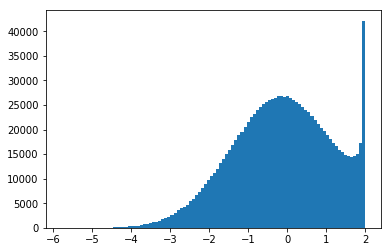

In [6]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.hist(np.log10(firm_prod['pct']).replace(-np.inf, np.nan).dropna().values, 100)
plt.show()